In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
from collections import Counter
from sklearn.metrics import classification_report,f1_score,accuracy_score,roc_auc_score
import torch
import torch.nn as nn
import torch.nn.functional as F

In [2]:
df = pd.read_csv('/Users/aadityajoshi/Downloads/waterQuality1.csv')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7999 entries, 0 to 7998
Data columns (total 21 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   aluminium    7999 non-null   float64
 1   ammonia      7999 non-null   object 
 2   arsenic      7999 non-null   float64
 3   barium       7999 non-null   float64
 4   cadmium      7999 non-null   float64
 5   chloramine   7999 non-null   float64
 6   chromium     7999 non-null   float64
 7   copper       7999 non-null   float64
 8   flouride     7999 non-null   float64
 9   bacteria     7999 non-null   float64
 10  viruses      7999 non-null   float64
 11  lead         7999 non-null   float64
 12  nitrates     7999 non-null   float64
 13  nitrites     7999 non-null   float64
 14  mercury      7999 non-null   float64
 15  perchlorate  7999 non-null   float64
 16  radium       7999 non-null   float64
 17  selenium     7999 non-null   float64
 18  silver       7999 non-null   float64
 19  uraniu

In [4]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
aluminium,7999.0,0.666158,1.265145,0.0,0.040,0.070,0.280,5.05
arsenic,7999.0,0.161445,0.252590,0.0,0.030,0.050,0.100,1.05
barium,7999.0,1.567715,1.216091,0.0,0.560,1.190,2.480,4.94
cadmium,7999.0,0.042806,0.036049,0.0,0.008,0.040,0.070,0.13
chloramine,7999.0,2.176831,2.567027,0.0,0.100,0.530,4.240,8.68
chromium,7999.0,0.247226,0.270640,0.0,0.050,0.090,0.440,0.90
copper,7999.0,0.805857,0.653539,0.0,0.090,0.750,1.390,2.00
flouride,7999.0,0.771565,0.435373,0.0,0.405,0.770,1.160,1.50
bacteria,7999.0,0.319665,0.329485,0.0,0.000,0.220,0.610,1.00
viruses,7999.0,0.328583,0.378096,0.0,0.002,0.008,0.700,1.00


In [5]:
df.head()

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,...,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium,is_safe
0,1.65,9.08,0.04,2.85,0.007,0.35,0.83,0.17,0.05,0.20,...,0.054,16.08,1.13,0.007,37.75,6.78,0.08,0.34,0.02,1
1,2.32,21.16,0.01,3.31,0.002,5.28,0.68,0.66,0.90,0.65,...,0.100,2.01,1.93,0.003,32.26,3.21,0.08,0.27,0.05,1
2,1.01,14.02,0.04,0.58,0.008,4.24,0.53,0.02,0.99,0.05,...,0.078,14.16,1.11,0.006,50.28,7.07,0.07,0.44,0.01,0
3,1.36,11.33,0.04,2.96,0.001,7.23,0.03,1.66,1.08,0.71,...,0.016,1.41,1.29,0.004,9.12,1.72,0.02,0.45,0.05,1
4,0.92,24.33,0.03,0.20,0.006,2.67,0.69,0.57,0.61,0.13,...,0.117,6.74,1.11,0.003,16.90,2.41,0.02,0.06,0.02,1


In [6]:
from ydata_profiling import ProfileReport
report = ProfileReport(df)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
df['is_safe'].value_counts()

is_safe
0        7084
1         912
#NUM!       3
Name: count, dtype: int64

In [8]:
df['is_safe'] = df['is_safe'].apply(lambda x : "0" if x == "#NUM!" else x)

<Axes: xlabel='is_safe', ylabel='count'>

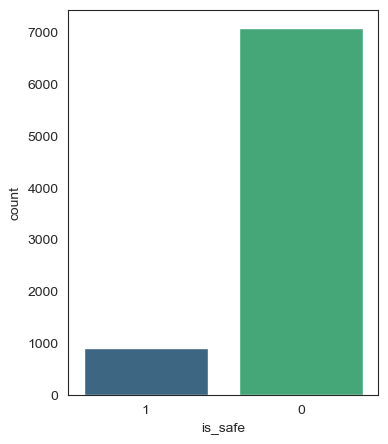

In [9]:
plt.figure(figsize=(4,5))
sns.set_style('white')
sns.countplot(x='is_safe',data=df,palette='viridis')

In [10]:
df['ammonia'] = df['ammonia'].apply(lambda x : 0 if x == '#NUM!' else float(x))

In [11]:
df['ammonia'].dtype

dtype('float64')

In [12]:
#missing
df.isnull().sum()

aluminium      0
ammonia        0
arsenic        0
barium         0
cadmium        0
chloramine     0
chromium       0
copper         0
flouride       0
bacteria       0
viruses        0
lead           0
nitrates       0
nitrites       0
mercury        0
perchlorate    0
radium         0
selenium       0
silver         0
uranium        0
is_safe        0
dtype: int64

In [13]:
df.drop_duplicates(inplace=True)

In [14]:
def plot_box(df):
    numerical_cols = list(df.select_dtypes(include='number').columns)
    num_plots = len(numerical_cols)
    nrows = (num_plots+1)//2
    ncols = 2
    fig, axes = plt.subplots(figsize=(20,40),nrows=nrows,ncols=ncols,facecolor='black')
    for i,column in enumerate(numerical_cols):
        row = i//2
        col = i%2
        ax = axes[row,col]
        ax.set_facecolor('black')
        sns.boxplot(x='is_safe',y=column,data=df,palette='rocket', linewidth=2.5, saturation=0.9,ax=ax,width=0.55)
        ax.set_title(f'Boxplot of {column}', color='white', fontsize=14, weight='bold')
        ax.set_xlabel(f'{column}', color='white', fontsize=12)
        ax.set_ylabel('Values', color='white', fontsize=12)
        
        ax.tick_params(axis='x', colors='white', labelsize=10)
        ax.tick_params(axis='y', colors='white', labelsize=10)
        
        for spine in ax.spines.values():
            spine.set_edgecolor('white')
        
        # Handle legend if present
        legend = ax.get_legend()
        if legend is not None:
            legend.get_frame().set_facecolor('black')
            legend.get_frame().set_edgecolor('white')
            plt.setp(legend.get_texts(), color='white')
    plt.tight_layout()
    plt.show()

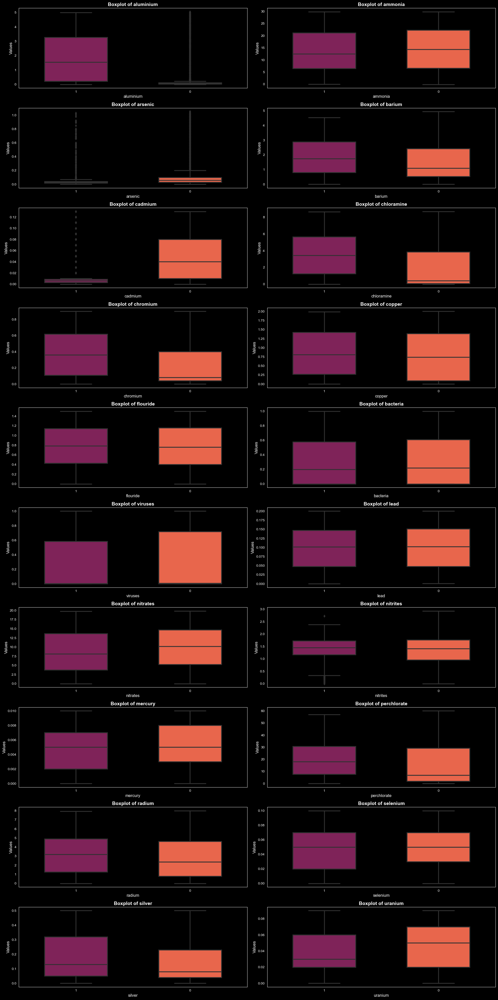

In [15]:
plot_box(df)

In [16]:
def plot_hist(df):
    numerical_cols = list(df.select_dtypes(include='number').columns)
    num_plots = len(numerical_cols)
    nrows = (num_plots+1)//2
    ncols = 2
    fig, axes = plt.subplots(figsize=(20,40),nrows=nrows,ncols=ncols,facecolor='black',linewidth=0.5)
    for i,column in enumerate(numerical_cols):
        row = i//2
        col = i%2
        ax = axes[row,col]
        ax.set_facecolor('black')
        sns.histplot(x=column,data=df,palette='viridis_r',hue='is_safe',ax=ax,bins=95,kde=True)
        ax.set_title(f'Boxplot of {column}', color='white', fontsize=14, weight='bold')
        ax.set_xlabel(f'{column}', color='white', fontsize=12)
        ax.set_ylabel('Values', color='white', fontsize=12)
        
        ax.tick_params(axis='x', colors='white', labelsize=10)
        ax.tick_params(axis='y', colors='white', labelsize=10)
        
        for spine in ax.spines.values():
            spine.set_edgecolor('white')
        
        # Handle legend if present
        legend = ax.get_legend()
        if legend is not None:
            legend.get_frame().set_facecolor('black')
            legend.get_frame().set_edgecolor('white')
            plt.setp(legend.get_texts(), color='white')
    plt.tight_layout()
    plt.show()

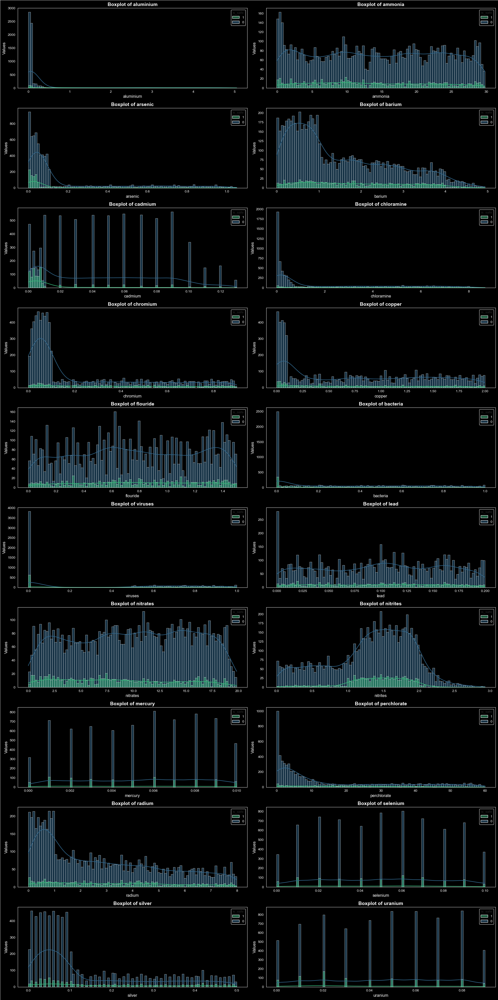

In [17]:
sns.set_style('white')
plot_hist(df)

<Axes: >

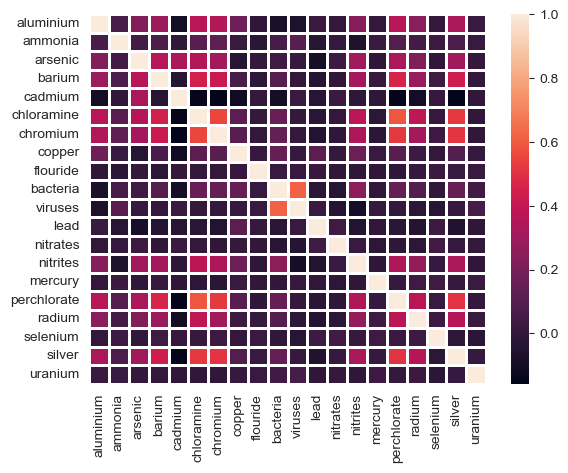

In [18]:
sns.heatmap(df.select_dtypes(include='number').corr(),cmap='rocket',linecolor='white',linewidths=0.8)

In [19]:
#splitting data
X = df.drop('is_safe',axis=1)
y = df['is_safe'].astype('category').cat.codes

In [20]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,stratify=y)

In [21]:
#scaler
from sklearn.preprocessing import StandardScaler
st_sclr = StandardScaler()
X_train = st_sclr.fit_transform(X_train)
X_test = st_sclr.transform(X_test)

### Oversampling target variable (ADASYN,SMOTE,SVMSMOTE,RandomOverSampler)

In [23]:
#smote
from imblearn.over_sampling import SMOTE
smote = SMOTE()
print(f"Before : {Counter(y_train)}")
X_train_smt,y_train_smt = smote.fit_resample(X_train,y_train)
print(f"After: {Counter(y_train_smt)}")

Before : Counter({0: 5669, 1: 730})
After: Counter({0: 5669, 1: 5669})


In [24]:
#svm
from imblearn.over_sampling import SVMSMOTE
svm_smote = SVMSMOTE()
print(f"Before : {Counter(y_train)}")
X_train_svm,y_train_svm = svm_smote.fit_resample(X_train,y_train)
print(f"After: {Counter(y_train_svm)}")

Before : Counter({0: 5669, 1: 730})
After: Counter({0: 5669, 1: 5669})


In [25]:
#random
from imblearn.over_sampling import RandomOverSampler
random_smote = RandomOverSampler()
print(f"Before : {Counter(y_train)}")
X_train_rnd,y_train_rnd = random_smote.fit_resample(X_train,y_train)
print(f"After: {Counter(y_train_rnd)}")

Before : Counter({0: 5669, 1: 730})
After: Counter({0: 5669, 1: 5669})


In [26]:
device = torch.device("mps")

In [27]:
X_train = torch.Tensor(X_train).to(device)
X_train_rnd = torch.Tensor(X_train_rnd).to(device)
X_train_smt = torch.Tensor(X_train_smt).to(device)
X_train_svm = torch.Tensor(X_train_svm).to(device)

In [28]:
y_train = torch.tensor(y_train.values,dtype=torch.int32).to(device)
y_train_rnd = torch.tensor(y_train_rnd,dtype=torch.int32).to(device)
y_train_smt = torch.tensor(y_train_smt,dtype=torch.int32).to(device)
y_train_svm = torch.tensor(y_train_svm,dtype=torch.int32).to(device)

In [29]:
X_test = torch.Tensor(X_test).to(device)

In [46]:
class Model(nn.Module):
    
    def __init__(self,in_features,h1,h2,h3,h4,h5,h6,h7,out_features=1):
        super().__init__()
        self.fc1 = nn.Linear(in_features,h1)
        self.fc2 = nn.Linear(h1,h2)
        self.fc3 = nn.Linear(h2,h3)
        self.fc4 = nn.Linear(h3,h4)
        self.fc5 = nn.Linear(h4,h5)
        self.fc6 = nn.Linear(h5,h6)
        self.fc7 = nn.Linear(h6,h7)
        self.dropout = nn.Dropout(p=0.3)
        
        self.out = nn.Linear(h7,out_features)
    def forward(self,x):
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))
        x = self.dropout(x)
        x = F.relu(self.fc3(x))
        x = self.dropout(x)
        x = F.relu(self.fc4(x))
        x = self.dropout(x)
        x = F.relu(self.fc5(x))
        x = self.dropout(x)
        x = F.relu(self.fc6(x))
        x = self.dropout(x)
        x = F.relu(self.fc7(x))
        x = self.out(x)
        x = torch.sigmoid(x)
        return x

In [47]:
model = Model(X.shape[1],256,128,64,32,16,8,4,2)

In [48]:
model.to(device)

Model(
  (fc1): Linear(in_features=20, out_features=256, bias=True)
  (fc2): Linear(in_features=256, out_features=128, bias=True)
  (fc3): Linear(in_features=128, out_features=64, bias=True)
  (fc4): Linear(in_features=64, out_features=32, bias=True)
  (fc5): Linear(in_features=32, out_features=16, bias=True)
  (fc6): Linear(in_features=16, out_features=8, bias=True)
  (fc7): Linear(in_features=8, out_features=4, bias=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (out): Linear(in_features=4, out_features=2, bias=True)
)

In [49]:
optimizer = torch.optim.Adam(model.parameters(),lr=0.01)
criterion = nn.CrossEntropyLoss()

In [63]:
losses = []
num_epochs = 150
for epoch in range(num_epochs):
    y_pred = model.forward(X_train)
    loss = criterion(y_pred,y_train)
    losses.append(loss)
    if (epoch+1)%10 == 0:
        print(f"epoch : {epoch+1} loss : {loss.item()}")
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

epoch : 10 loss : 0.33871540427207947
epoch : 20 loss : 0.3382994830608368
epoch : 30 loss : 0.3382079005241394
epoch : 40 loss : 0.3383743166923523
epoch : 50 loss : 0.3394036293029785
epoch : 60 loss : 0.3391396999359131
epoch : 70 loss : 0.33845254778862
epoch : 80 loss : 0.33729031682014465
epoch : 90 loss : 0.33888664841651917
epoch : 100 loss : 0.34103691577911377
epoch : 110 loss : 0.33897721767425537
epoch : 120 loss : 0.3387570083141327
epoch : 130 loss : 0.338264524936676
epoch : 140 loss : 0.338706910610199
epoch : 150 loss : 0.33903130888938904


In [64]:
with torch.no_grad():
    prediction = model.forward(X_test)

In [65]:
pred_numpy = torch.argmax(prediction,axis=1).cpu().numpy()

In [66]:
print(classification_report(y_test,pred_numpy))

              precision    recall  f1-score   support

           0       0.96      0.99      0.98      1418
           1       0.90      0.70      0.79       182

    accuracy                           0.96      1600
   macro avg       0.93      0.85      0.88      1600
weighted avg       0.96      0.96      0.95      1600



### for random oversampling

In [84]:
model_rnd = Model(X.shape[1],256,128,64,32,16,8,4,2).to(device)

In [85]:
optimizer = torch.optim.Adam(model_rnd.parameters(),lr=0.01)
criterion = nn.CrossEntropyLoss()
losses = []
num_epochs = 2500
for epoch in range(num_epochs):
    #change model
    y_pred = model_rnd.forward(X_train_rnd)
    loss = criterion(y_pred,y_train_rnd)
    losses.append(loss)
    if (epoch+1)%100 == 0:
        print(f"epoch : {epoch+1} loss : {loss.item()}")
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

epoch : 100 loss : 0.4569748342037201
epoch : 200 loss : 0.3794183135032654
epoch : 300 loss : 0.3539905548095703
epoch : 400 loss : 0.3408258259296417
epoch : 500 loss : 0.33448174595832825
epoch : 600 loss : 0.3322089910507202
epoch : 700 loss : 0.32846948504447937
epoch : 800 loss : 0.32688719034194946
epoch : 900 loss : 0.32553979754447937
epoch : 1000 loss : 0.3246634602546692
epoch : 1100 loss : 0.3261600434780121
epoch : 1200 loss : 0.32541605830192566
epoch : 1300 loss : 0.32366976141929626
epoch : 1400 loss : 0.3261180520057678
epoch : 1500 loss : 0.324028879404068
epoch : 1600 loss : 0.32683664560317993
epoch : 1700 loss : 0.3256860375404358
epoch : 1800 loss : 0.3254719376564026
epoch : 1900 loss : 0.32467150688171387
epoch : 2000 loss : 0.3227614760398865
epoch : 2100 loss : 0.321755975484848
epoch : 2200 loss : 0.32219818234443665
epoch : 2300 loss : 0.3238937258720398
epoch : 2400 loss : 0.32292047142982483
epoch : 2500 loss : 0.3211067020893097


In [86]:
with torch.no_grad():
    prediction_rnd = model_rnd.forward(X_test)
pred_numpy_rnd= torch.argmax(prediction_rnd,axis=1).cpu().numpy()

In [87]:
print(classification_report(y_test,pred_numpy_rnd))

              precision    recall  f1-score   support

           0       0.98      0.96      0.97      1418
           1       0.75      0.82      0.78       182

    accuracy                           0.95      1600
   macro avg       0.86      0.89      0.88      1600
weighted avg       0.95      0.95      0.95      1600



### for svm oversample

In [89]:
model_svm = Model(X.shape[1],256,128,64,32,16,8,4,2).to(device)
optimizer = torch.optim.Adam(model_svm.parameters(),lr=0.01)
criterion = nn.CrossEntropyLoss()
losses = []
num_epochs = 2000
for epoch in range(num_epochs):
    #change model
    y_pred = model_svm.forward(X_train_svm)
    loss = criterion(y_pred,y_train_svm)
    losses.append(loss)
    if (epoch+1)%100 == 0:
        print(f"epoch : {epoch+1} loss : {loss.item()}")
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

epoch : 100 loss : 0.3954325318336487
epoch : 200 loss : 0.3627409040927887
epoch : 300 loss : 0.3479834794998169
epoch : 400 loss : 0.33788812160491943
epoch : 500 loss : 0.33535265922546387
epoch : 600 loss : 0.3293933868408203
epoch : 700 loss : 0.3269275426864624
epoch : 800 loss : 0.32649901509284973
epoch : 900 loss : 0.3243100047111511
epoch : 1000 loss : 0.3258680999279022
epoch : 1100 loss : 0.32420745491981506
epoch : 1200 loss : 0.3259885311126709
epoch : 1300 loss : 0.3252103328704834
epoch : 1400 loss : 0.3233538269996643
epoch : 1500 loss : 0.325621098279953
epoch : 1600 loss : 0.32515496015548706
epoch : 1700 loss : 0.3250981271266937
epoch : 1800 loss : 0.32281777262687683
epoch : 1900 loss : 0.3236719071865082
epoch : 2000 loss : 0.3254227936267853


In [90]:
with torch.no_grad():
    prediction_svm = model_svm.forward(X_test)
pred_numpy_svm= torch.argmax(prediction_svm,axis=1).cpu().numpy()
print(classification_report(y_test,pred_numpy_svm))

              precision    recall  f1-score   support

           0       0.98      0.97      0.97      1418
           1       0.77      0.82      0.79       182

    accuracy                           0.95      1600
   macro avg       0.87      0.89      0.88      1600
weighted avg       0.95      0.95      0.95      1600



### for smote

In [93]:
model_smt = Model(X.shape[1],256,128,64,32,16,8,4,2).to(device)
optimizer = torch.optim.Adam(model_smt.parameters(),lr=0.01)
criterion = nn.CrossEntropyLoss()
losses = []
num_epochs = 2000
for epoch in range(num_epochs):
    #change model
    y_pred = model_smt.forward(X_train_smt)
    loss = criterion(y_pred,y_train_smt)
    losses.append(loss)
    if (epoch+1)%100 == 0:
        print(f"epoch : {epoch+1} loss : {loss.item()}")
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

epoch : 100 loss : 0.3869665563106537
epoch : 200 loss : 0.3476967215538025
epoch : 300 loss : 0.3349238932132721
epoch : 400 loss : 0.3291364908218384
epoch : 500 loss : 0.326327919960022
epoch : 600 loss : 0.3263610303401947
epoch : 700 loss : 0.3233218491077423
epoch : 800 loss : 0.3243235647678375
epoch : 900 loss : 0.32216188311576843
epoch : 1000 loss : 0.32191863656044006
epoch : 1100 loss : 0.32172533869743347
epoch : 1200 loss : 0.32095763087272644
epoch : 1300 loss : 0.32057300209999084
epoch : 1400 loss : 0.32197293639183044
epoch : 1500 loss : 0.3211347460746765
epoch : 1600 loss : 0.32057297229766846
epoch : 1700 loss : 0.3204679787158966
epoch : 1800 loss : 0.32030928134918213
epoch : 1900 loss : 0.3210345506668091
epoch : 2000 loss : 0.3220389783382416


In [95]:
with torch.no_grad():
    prediction_smt = model_smt.forward(X_test)
pred_numpy_smt = torch.argmax(prediction_smt,axis=1).cpu().numpy()
print(classification_report(y_test,pred_numpy_smt))

              precision    recall  f1-score   support

           0       0.98      0.96      0.97      1418
           1       0.70      0.82      0.76       182

    accuracy                           0.94      1600
   macro avg       0.84      0.89      0.86      1600
weighted avg       0.95      0.94      0.94      1600



In [107]:
class Model_2(nn.Module):
    
    def __init__(self, in_features, h1, h2, h3, h4, h5, h6, h7, h8, h9,out_features):
        super().__init__()
        self.fc1 = nn.Linear(in_features, h1)
        self.fc2 = nn.Linear(h1, h2)
        self.fc3 = nn.Linear(h2, h3)
        self.fc4 = nn.Linear(h3, h4)
        self.fc5 = nn.Linear(h4, h5)
        self.fc6 = nn.Linear(h5, h6)
        self.fc7 = nn.Linear(h6, h7)
        self.fc8 = nn.Linear(h7, h8)
        self.fc9 = nn.Linear(h8, h9)
        self.dropout = nn.Dropout(p=0.3)
        
        self.out = nn.Linear(h9, out_features)
    
    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))
        x = self.dropout(x)
        x = F.relu(self.fc3(x))
        x = self.dropout(x)
        x = F.relu(self.fc4(x))
        x = self.dropout(x)
        x = F.relu(self.fc5(x))
        x = self.dropout(x)
        x = F.relu(self.fc6(x))
        x = self.dropout(x)
        x = F.relu(self.fc7(x))
        x = self.dropout(x)
        x = F.relu(self.fc8(x))
        x = self.dropout(x)
        x = F.relu(self.fc9(x))
        x = self.dropout(x)
        x = self.out(x)
        x = torch.sigmoid(x)
        return x

In [108]:
model_2 = Model_2(X.shape[1],1024,512,256,128,64,32,16,8,4,2).to(device)

In [109]:
model_2

Model_2(
  (fc1): Linear(in_features=20, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=256, bias=True)
  (fc4): Linear(in_features=256, out_features=128, bias=True)
  (fc5): Linear(in_features=128, out_features=64, bias=True)
  (fc6): Linear(in_features=64, out_features=32, bias=True)
  (fc7): Linear(in_features=32, out_features=16, bias=True)
  (fc8): Linear(in_features=16, out_features=8, bias=True)
  (fc9): Linear(in_features=8, out_features=4, bias=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (out): Linear(in_features=4, out_features=2, bias=True)
)

In [ ]:
optimizer = torch.optim.Adam(model_2.parameters(),lr=0.01)
criterion = nn.CrossEntropyLoss()
losses = []
num_epochs = 200
for epoch in range(num_epochs):
    #change model
    y_pred = model_2.forward(X_train)
    loss = criterion(y_pred,y_train)
    losses.append(loss)
    if (epoch+1)%100 == 0:
        print(f"epoch : {epoch+1} loss : {loss.item()}")
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

epoch : 100 loss : 0.434963583946228
